In [35]:
import pandas as pd
import numpy as np
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict
import glob

path = "./data"

csv_files = glob.glob(path + "/*.csv")
dfs = [pd.read_csv(file) for file in csv_files]
data = pd.concat(dfs, ignore_index=True)
data['Date'] = pd.to_datetime(data['Date'], errors='coerce')
data = data.sort_values(by='Date', ascending=True)
data = data.reset_index(drop=True)

print(data.head())
data.to_csv("./data/tennis_data.csv", index=False)

   ATP  Location          Tournament       Date         Series    Court  \
0    1  Adelaide  AAPT Championships 2001-01-01  International  Outdoor   
1    3      Doha          Qatar Open 2001-01-01  International  Outdoor   
2    3      Doha          Qatar Open 2001-01-01  International  Outdoor   
3    3      Doha          Qatar Open 2001-01-01  International  Outdoor   
4    3      Doha          Qatar Open 2001-01-01  International  Outdoor   

  Surface      Round  Best of          Winner  ...  IWW  IWL   GBW   GBL  SBW  \
0    Hard  1st Round      3.0      Clement A.  ...  NaN  NaN   NaN   NaN  NaN   
1    Hard  1st Round      3.0   Kafelnikov Y.  ...  1.3  2.4  1.27  2.80  NaN   
2    Hard  1st Round      3.0      Jonsson F.  ...  1.9  1.5  2.00  1.57  NaN   
3    Hard  1st Round      3.0       Escude N.  ...  NaN  NaN   NaN   NaN  NaN   
4    Hard  1st Round      3.0  di Pasquale A.  ...  1.8  1.6  1.67  1.85  NaN   

   SBL  BFEW BFEL B&WW B&WL  
0  NaN   NaN  NaN  NaN  NaN  
1 

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from collections import defaultdict

file = "./data/tennis_data.csv"
data = pd.read_csv(file)
print(data.shape)
print(data.tail())

(60717, 59)
       ATP Location     Tournament        Date  Series   Court Surface  \
60712   55    Basel  Swiss Indoors  2025-10-25  ATP500  Indoor    Hard   
60713   55    Basel  Swiss Indoors  2025-10-25  ATP500  Indoor    Hard   
60714   56   Vienna    Vienna Open  2025-10-25  ATP500  Indoor    Hard   
60715   56   Vienna    Vienna Open  2025-10-26  ATP500  Indoor    Hard   
60716   55    Basel  Swiss Indoors  2025-10-26  ATP500  Indoor    Hard   

            Round  Best of                Winner  ... IWW  IWL GBW  GBL  SBW  \
60712  Semifinals      3.0  Davidovich Fokina A.  ... NaN  NaN NaN  NaN  NaN   
60713  Semifinals      3.0            Fonseca J.  ... NaN  NaN NaN  NaN  NaN   
60714  Semifinals      3.0             Zverev A.  ... NaN  NaN NaN  NaN  NaN   
60715   The Final      3.0             Sinner J.  ... NaN  NaN NaN  NaN  NaN   
60716   The Final      3.0            Fonseca J.  ... NaN  NaN NaN  NaN  NaN   

       SBL  BFEW  BFEL B&WW B&WL  
60712  NaN  2.38  1.72  NaN

/tmp/ipykernel_8288/2516841973.py:10: DtypeWarning: Columns (12,17,18,19,20,39) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(file)


In [65]:

def compute_elo(rw, rl, k=32):
    exp_w = 1.0 / (1.0 + 10 ** ((rl - rw) / 400.0))
    delta = k * (1 - exp_w)
    rw_after = rw + delta
    rl_after = rl - delta
    return rw_after, rl_after

def normalize_surface(s):
    if pd.isna(s):
        return None
    s = str(s).strip().lower()
    if 'hard' in s:
        return 'Hard'
    if 'clay' in s:
        return 'Clay'
    if 'grass' in s:
        return 'Grass'
    if 'carpet' in s:
        return 'Carpet'
    return None

def normalize_court(c):
    if pd.isna(c):
        return None
    c = str(c).strip().lower()
    if 'indo' in c:
        return 'Indoors'
    if 'out' in c:
        return 'Outdoors'
    return None

def bin_temperature(temp):
    if temp < 20:
        return 'low'
    elif temp < 27:
        return 'medium'
    else:
        return 'high'

def bin_humidity(hum):
    if hum < 40:
        return 'low'
    elif hum < 70:
        return 'medium'
    else:
        return 'high'


def calculate_player_elo_env_diff(match_data, player_data=None, default_elo=1500, k=32, record_history=True):
    surface_cols = ['Hard_Elo', 'Clay_Elo', 'Grass_Elo', 'Carpet_Elo']
    inout_cols = ['Indoors_Elo', 'Outdoors_Elo']
    temp_cols = ['Temp_Elo_low', 'Temp_Elo_medium', 'Temp_Elo_high']
    hum_cols = ['Hum_Elo_low', 'Hum_Elo_medium', 'Hum_Elo_high']
    all_cols = ['Overall_Elo'] + surface_cols + inout_cols + temp_cols + hum_cols

    if player_data is None:
        player_data = pd.DataFrame(columns=all_cols).set_index(pd.Index([], name='Player'))

    match_records = []
    h2h = defaultdict(int)

    for idx, match in match_data.iterrows():
        winner = match.get('Winner')
        loser = match.get('Loser')
        if pd.isna(winner) or pd.isna(loser):
            continue

        surface = normalize_surface(match.get('Surface'))
        court = normalize_court(match.get('Court'))
        date = match.get('Date', match.get('Data'))
        temp_bin = bin_temperature(match.get('temp_matchday')) if not pd.isna(match.get('temp_matchday')) else None
        hum_bin = bin_humidity(match.get('humidity_matchday')) if not pd.isna(match.get('humidity_matchday')) else None

        for p in (winner, loser):
            if p not in player_data.index:
                player_data.loc[p] = {c: float(default_elo) for c in all_cols}

        winner_h2h_prior = h2h[(winner, loser)]
        loser_h2h_prior = h2h[(loser, winner)]

        rw, rl = float(player_data.loc[winner, 'Overall_Elo']), float(player_data.loc[loser, 'Overall_Elo'])
        rw_after, rl_after = compute_elo(rw, rl, k=k)
        player_data.loc[winner, 'Overall_Elo'] = rw_after
        player_data.loc[loser, 'Overall_Elo'] = rl_after

        rw_s = rl_s = np.nan
        if surface:
            col = f"{surface}_Elo"
            rw_s = float(player_data.loc[winner, col])
            rl_s = float(player_data.loc[loser, col])
            rw_s_after, rl_s_after = compute_elo(rw_s, rl_s, k=k)
            player_data.loc[winner, col] = rw_s_after
            player_data.loc[loser, col] = rl_s_after

        rw_c = rl_c = np.nan
        if court:
            col = f"{court}_Elo"
            rw_c = float(player_data.loc[winner, col])
            rl_c = float(player_data.loc[loser, col])
            rw_c_after, rl_c_after = compute_elo(rw_c, rl_c, k=k)
            player_data.loc[winner, col] = rw_c_after
            player_data.loc[loser, col] = rl_c_after

        def get_climate_elo(player):
            vals = []
            if temp_bin:
                vals.append(player_data.loc[player, f"Temp_Elo_{temp_bin}"])
            if hum_bin:
                vals.append(player_data.loc[player, f"Hum_Elo_{hum_bin}"])
            return np.mean(vals) if vals else np.nan

        rw_climate = get_climate_elo(winner)
        rl_climate = get_climate_elo(loser)
        player_climate_elo_diff_w = rw_climate - rl_climate if not (np.isnan(rw_climate) or np.isnan(rl_climate)) else np.nan
        player_climate_elo_diff_l = rl_climate - rw_climate if not (np.isnan(rw_climate) or np.isnan(rl_climate)) else np.nan

        if temp_bin:
            col = f"Temp_Elo_{temp_bin}"
            rw_t, rl_t = player_data.loc[winner, col], player_data.loc[loser, col]
            rw_t_after, rl_t_after = compute_elo(rw_t, rl_t, k=k)
            player_data.loc[winner, col] = rw_t_after
            player_data.loc[loser, col] = rl_t_after

        if hum_bin:
            col = f"Hum_Elo_{hum_bin}"
            rw_h, rl_h = player_data.loc[winner, col], player_data.loc[loser, col]
            rw_h_after, rl_h_after = compute_elo(rw_h, rl_h, k=k)
            player_data.loc[winner, col] = rw_h_after
            player_data.loc[loser, col] = rl_h_after

        h2h[(winner, loser)] += 1

        if record_history:
            w_rank = pd.to_numeric(match.get('WRank'), errors='coerce')
            l_rank = pd.to_numeric(match.get('LRank'), errors='coerce')
            avg_win = pd.to_numeric(match.get('AvgW'), errors='coerce')
            avg_loss = pd.to_numeric(match.get('AvgL'), errors='coerce')
            atp_points_W = pd.to_numeric(match.get('WPts'), errors='coerce')
            atp_points_L = pd.to_numeric(match.get('LPts'), errors='coerce')    

            total_games = 0
            for i in range(1, 6):  # For sets 1 to 5
                w_col = f"W{i}"
                l_col = f"L{i}"
                if w_col in match and l_col in match:
                    w_val = pd.to_numeric(match.get(w_col), errors='coerce')
                    l_val = pd.to_numeric(match.get(l_col), errors='coerce')
                    if not pd.isna(w_val) and not pd.isna(l_val):
                        total_games += w_val + l_val

            match_records.append({
                'MatchIndex': idx,
                'Temp_bin': temp_bin,
                'Hum_bin': hum_bin,
                'Date': date,
                'Player': winner,
                'Opponent': loser,
                'Outcome': 1,
                'Elo-diff': float(rw) - float(rl),
                'Player_surface_elo_diff': (rw_s - rl_s) if not (np.isnan(rw_s) or np.isnan(rl_s)) else np.nan,
                'Player_court_elo_diff': (rw_c - rl_c) if not (np.isnan(rw_c) or np.isnan(rl_c)) else np.nan,
                'Player_climate_elo_diff': player_climate_elo_diff_w,
                'Rank-diff': w_rank - l_rank,
                'SetsFor': pd.to_numeric(match.get('Wsets'), errors='coerce'),
                'SetsAgainst': pd.to_numeric(match.get('Lsets'), errors='coerce'),
                'TotalGames': total_games,
                'Surface': surface,
                'Court': court,
                'H2H_Wins_vs_Opp': winner_h2h_prior,
                'H2H_Losses_vs_Opp': loser_h2h_prior,
                'H2H_Total_prior': winner_h2h_prior + loser_h2h_prior,
                'H2H_win_rate' : loser_h2h_prior / max(winner_h2h_prior + loser_h2h_prior, 1),
                'Atp_points_diff': atp_points_W-atp_points_L,
                'AvgOdds': avg_win
            })

            match_records.append({
                'MatchIndex': idx,
                'Temp_bin': temp_bin,
                'Hum_bin': hum_bin,
                'Date': date,
                'Player': loser,
                'Opponent': winner,
                'Outcome': 0,
                'Elo-diff': float(rl) - float(rw),
                'Player_surface_elo_diff': (rl_s - rw_s) if not (np.isnan(rw_s) or np.isnan(rl_s)) else np.nan,
                'Player_court_elo_diff': (rl_c - rw_c) if not (np.isnan(rw_c) or np.isnan(rl_c)) else np.nan,
                'Player_climate_elo_diff': player_climate_elo_diff_l,
                'Rank-diff': l_rank - w_rank,
                'SetsFor': pd.to_numeric(match.get('Lsets'), errors='coerce'),
                'SetsAgainst': pd.to_numeric(match.get('Wsets'), errors='coerce'),
                'TotalGames': total_games,
                'Surface': surface,
                'Court': court,
                'H2H_Wins_vs_Opp': loser_h2h_prior,
                'H2H_Losses_vs_Opp': winner_h2h_prior,
                'H2H_Total_prior': winner_h2h_prior + loser_h2h_prior,
                'H2H_win_rate' : loser_h2h_prior / max(winner_h2h_prior + loser_h2h_prior, 1),
                'Atp_points_diff': atp_points_L-atp_points_W,
                'AvgOdds': avg_loss
            })

    match_df = pd.DataFrame(match_records)
    return player_data, match_df



if 'MatchIndex' not in data.columns:
    data['MatchIndex'] = np.arange(len(data))

data = data.sort_values(['Date', 'MatchIndex']).reset_index(drop=True)


train_cutoff = '2025-01-01'   # for test
train_cutoff_2 = '2024-07-01' # for validation


train_raw = data[data['Date'] < train_cutoff].copy()


train_fit = train_raw[train_raw['Date'] < train_cutoff_2]
train_val = train_raw[train_raw['Date'] >= train_cutoff_2]


test_raw  = data[data['Date'] >= train_cutoff].copy()

player_data_train, train_df = calculate_player_elo_env_diff(
    train_fit,
    player_data=None,
    default_elo=1500,
    k=64,
    record_history=True
)

player_data_validation, validation_df = calculate_player_elo_env_diff(
    train_val,
    player_data=player_data_train.copy(),
    default_elo=1500,
    k=64,
    record_history=True
)


player_data_test, test_df = calculate_player_elo_env_diff(
    test_raw,
    player_data=player_data_validation.copy(),
    default_elo=1500,
    k=64,
    record_history=True
)






In [73]:
def add_recent_win_rates(match_df):
    match_df = match_df.sort_values(['Player', 'Date']).copy()
    match_df['RecentWinPct_5'] = (
        match_df.groupby('Player')['Outcome']
        .apply(lambda x: x.rolling(window=5, min_periods=1).mean().shift(1))
        .reset_index(level=0, drop=True)
    )
    match_df['RecentWinPct_10'] = (
        match_df.groupby('Player')['Outcome']
        .apply(lambda x: x.rolling(window=10, min_periods=1).mean().shift(1))
        .reset_index(level=0, drop=True)
    )
    return match_df

def add_fatigue_features(match_df):
    match_df = match_df.sort_values(['Player', 'Date']).copy()
    match_df['Date'] = pd.to_datetime(match_df['Date'])
    match_df['DaysSinceLastMatch'] = match_df.groupby('Player')['Date'].diff().dt.days
    def rolling_matches_last7(x):
        return x.rolling('7D').count().shift(1)
    match_df['MatchesLast7'] = (
        match_df.groupby('Player', group_keys=False)
        .apply(lambda df: rolling_matches_last7(df.set_index('Date').index.to_series()))
        .reset_index(level=0, drop=True)
    )
    match_df['DaysSinceLastMatch'] = match_df['DaysSinceLastMatch'].fillna(999)
    match_df['MatchesLast7'] = match_df['MatchesLast7'].fillna(0)
    return match_df

def add_recent_games(match_df):
    match_df = match_df.sort_values(['Player', 'Date']).copy()
    match_df['Date'] = pd.to_datetime(match_df['Date'])
    def rolling_games_last7(df):
        s = df.set_index('Date')['TotalGames']
        return s.rolling('7D').sum().shift(1)
    match_df['GamesLast7'] = (
        match_df.groupby('Player', group_keys=False)
        .apply(rolling_games_last7)
        .reset_index(level=0, drop=True)
    )
    match_df['GamesLast7'] = match_df['GamesLast7'].fillna(0)
    return match_df

def enrich_features(df):
    df = add_recent_games(df)
    df = add_recent_win_rates(df)
    df = add_fatigue_features(df)
    df['WinStreak'] = (
        df.groupby('Player')['Outcome']
        .apply(lambda x: (x.shift(1).cumsum() - x.shift(1).cumsum().where(x.shift(1)==0).ffill().fillna(0)))
        .reset_index(level=0, drop=True)
    )
    df['LossStreak'] = (
        df.groupby('Player')['Outcome']
        .apply(lambda x: ((1-x).shift(1).cumsum() - (1-x).shift(1).cumsum().where(x.shift(1)==1).ffill().fillna(0)))
        .reset_index(level=0, drop=True)
    )
    df['Elo_diff_fatigue'] = df['Elo-diff'] - 0.1 * df['GamesLast7']
    df['Surface_Elo_RecentWin'] = df['Player_surface_elo_diff'] * df['RecentWinPct_5']
    df['Elo_RankDiff'] = df['Elo-diff'] * df['Rank-diff']
    df['Fatigue_Streak'] = df['GamesLast7'] * df['WinStreak']
    df['log_GamesLast7'] = np.log1p(df['GamesLast7'])
    df['log_H2H_Total_prior'] = np.log1p(df['H2H_Total_prior'])
    return df

train_df = enrich_features(train_df)
validation_df = enrich_features(train_df)
test_df  = enrich_features(test_df)

test_overlap = set(train_df['Player']).intersection(set(test_df['Player']))
print("Player overlap between train and test:", round(len(test_overlap) / len(set(train_df['Player'])) * 100, 2), "%")

train_last = train_df.groupby('Player')['Date'].max()
test_first = test_df.groupby('Player')['Date'].min()

common_players = train_last.index.intersection(test_first.index)
leak_check = (test_first.loc[common_players] > train_last.loc[common_players]).all()

print("Chronological integrity:", leak_check)


/tmp/ipykernel_8288/1065777375.py:38: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(rolling_games_last7)
/tmp/ipykernel_8288/1065777375.py:23: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda df: rolling_matches_last7(df.set_index('Date').index.to_series()))
/tmp/ipykernel_8288/1065777375.py:38: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and 

Player overlap between train and test: 14.09 %
Chronological integrity: True


Index(['MatchIndex', 'Temp_bin', 'Hum_bin', 'Date', 'Player', 'Opponent',
       'Outcome', 'Elo-diff', 'Player_surface_elo_diff',
       'Player_court_elo_diff', 'Player_climate_elo_diff', 'Rank-diff',
       'SetsFor', 'SetsAgainst', 'TotalGames', 'Surface', 'Court',
       'H2H_Wins_vs_Opp', 'H2H_Losses_vs_Opp', 'H2H_Total_prior',
       'H2H_win_rate', 'Atp_points_diff', 'AvgOdds', 'GamesLast7',
       'RecentWinPct_5', 'RecentWinPct_10', 'DaysSinceLastMatch',
       'MatchesLast7', 'WinStreak', 'LossStreak', 'Elo_diff_fatigue',
       'Surface_Elo_RecentWin', 'Elo_RankDiff', 'Fatigue_Streak',
       'log_GamesLast7', 'log_H2H_Total_prior'],
      dtype='object')


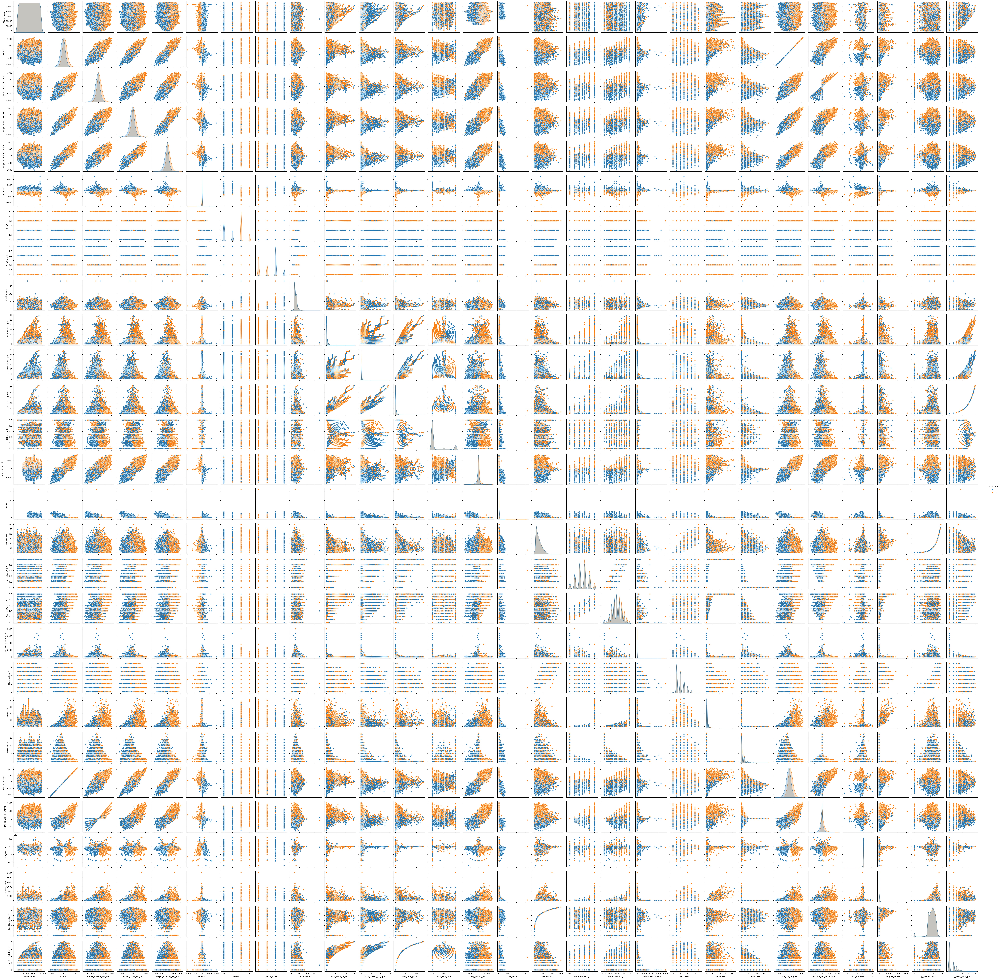

In [145]:
print(train_df.columns)
sns.pairplot(train_df, hue="Outcome")



In [74]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score, classification_report
import xgboost as xgb

num_features = [
    # ELO and ranking differences
    'Elo-diff',
    'Elo_diff_fatigue',           
    'Player_surface_elo_diff',
    'Player_court_elo_diff',
    'Player_climate_elo_diff',
    'Rank-diff',
    'Elo_RankDiff',        
    'Atp_points_diff',
    
    
    'H2H_Wins_vs_Opp',
    'H2H_Losses_vs_Opp',
    'H2H_Total_prior',
    'H2H_win_rate',
    'log_H2H_Total_prior',
    
    # Recent form / momentum
    'RecentWinPct_5',
    'RecentWinPct_10',
    'WinStreak',
    'LossStreak',
    'Surface_Elo_RecentWin',
    
    # Fatigue / workload
    'DaysSinceLastMatch',
    'MatchesLast7',
    'GamesLast7',
    'log_GamesLast7',
    'Fatigue_Streak'
]


cat_features = ['Surface', 'Court', 'Temp_bin', 'Hum_bin']
feature_cols = num_features + cat_features


X_train = pd.get_dummies(train_df[feature_cols], drop_first=True)
y_train = train_df["Outcome"].astype(int)

X_test = pd.get_dummies(test_df[feature_cols], drop_first=True)
y_test = test_df["Outcome"].astype(int)

X_test = X_test.reindex(columns=X_train.columns, fill_value=0)


model = XGBClassifier(
    n_estimators=500,
    learning_rate=0.05,
    max_depth=5,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    use_label_encoder=False,
    eval_metric='logloss'
)



/home/ilpoaunio/Documents/misc-coding/tennis-pred/.venv/lib/python3.12/site-packages/xgboost/training.py:183: UserWarning: [14:36:19] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


Accuracy: 0.682784911717496
ROC AUC: 0.767615438423823

Classification Report:
               precision    recall  f1-score   support

           0       0.68      0.70      0.69      2492
           1       0.69      0.67      0.68      2492

    accuracy                           0.68      4984
   macro avg       0.68      0.68      0.68      4984
weighted avg       0.68      0.68      0.68      4984



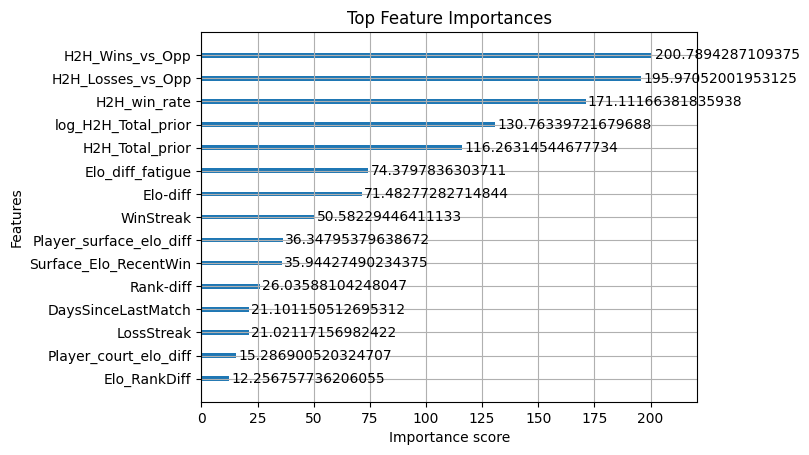

'\nbin 25\nAccuracy: 0.6370385232744783\nROC AUC: 0.6952810792288131\n\n\nbin 28\nAccuracy: 0.6364365971107544\nROC AUC: 0.6957615895746001\n\nbin 27\nAccuracy: 0.6390449438202247\nROC AUC: 0.6960801048105141\n\nAccuracy: 0.7827046548956661\nROC AUC: 0.8897241638733515\n'

In [ ]:
model.fit(X_train, y_train)
y_pred_prob = model.predict_proba(X_test)[:, 1]
y_pred = (y_pred_prob >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("ROC AUC:", roc_auc_score(y_test, y_pred_prob))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

xgb.plot_importance(model, importance_type='gain', max_num_features=15)
plt.title("Top Feature Importances")
plt.show()

"""
tests between temperature bins


bin 25
Accuracy: 0.6370385232744783
ROC AUC: 0.6952810792288131


bin 28
Accuracy: 0.6364365971107544
ROC AUC: 0.6957615895746001

bin 27
Accuracy: 0.6390449438202247
ROC AUC: 0.6960801048105141

Accuracy: 0.7827046548956661
ROC AUC: 0.8897241638733515
"""

In [101]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV

param_grid = {
    'n_estimators': [800, 1200],
    'learning_rate': [0.02, 0.05],
    'max_depth': [4, 6, 8],
    'subsample': [0.7, 0.9],
    'colsample_bytree': [0.7, 0.9],
    'min_child_weight': [1, 3, 5],
    'gamma': [0, 0.2, 0.4],
    'reg_lambda': [1, 5, 10],
    'reg_alpha': [0, 0.1, 0.5]
}

model = XGBClassifier(
    objective='binary:logistic',
    eval_metric='auc',
    tree_method='hist',
    random_state=42,
)

search = RandomizedSearchCV(
    model,
    param_distributions=param_grid,
    n_iter=40,
    scoring='roc_auc',
    cv=3,
    verbose=1,
    n_jobs=-1,
    random_state=42
)
search.fit(X_train, y_train)
print("Best params:", search.best_params_)

best_model = search.best_estimator_
best_model.save_model("xgb_tennis_model.json")

Fitting 3 folds for each of 40 candidates, totalling 120 fits
Best params: {'subsample': 0.9, 'reg_lambda': 5, 'reg_alpha': 0.1, 'n_estimators': 1200, 'min_child_weight': 1, 'max_depth': 4, 'learning_rate': 0.05, 'gamma': 0.2, 'colsample_bytree': 0.7}


In [102]:
best_model.save_model("xgb_tennis_model.json")

In [78]:
from xgboost import XGBClassifier

best_model = XGBClassifier()
best_model.load_model("xgb_tennis_model.json")

In [ ]:
from sklearn.calibration import CalibratedClassifierCV, calibration_curve, FrozenEstimator
from sklearn.metrics import accuracy_score, roc_auc_score, brier_score_loss, classification_report
from sklearn.model_selection import TimeSeriesSplit

X_calib = pd.get_dummies(validation_df[feature_cols], drop_first=True)
y_calib = validation_df["Outcome"].astype(int)
X_calib = X_calib.reindex(columns=X_train.columns, fill_value=0)

tscv = TimeSeriesSplit(n_splits=5)
frozen_model = FrozenEstimator(best_model)
calibrator = CalibratedClassifierCV(frozen_model, method='isotonic')
calibrator.fit(X_calib, y_calib)

y_test_prob = calibrator.predict_proba(X_test)[:, 1]
y_test_pred = (y_test_prob >= 0.5).astype(int)

print("Accuracy (2025):", accuracy_score(y_test, y_test_pred))
print("ROC AUC (2025):", roc_auc_score(y_test, y_test_prob))
print("Brier Score (2025):", brier_score_loss(y_test, y_test_prob))
print("\nClassification Report:\n", classification_report(y_test, y_test_pred))


test_df['ModelProb'] = y_test_prob


Accuracy (2025): 0.6819823434991974
ROC AUC (2025): 0.7670834793329022
Brier Score (2025): 0.19791004785104763

Classification Report:
               precision    recall  f1-score   support

           0       0.68      0.68      0.68      2492
           1       0.68      0.68      0.68      2492

    accuracy                           0.68      4984
   macro avg       0.68      0.68      0.68      4984
weighted avg       0.68      0.68      0.68      4984



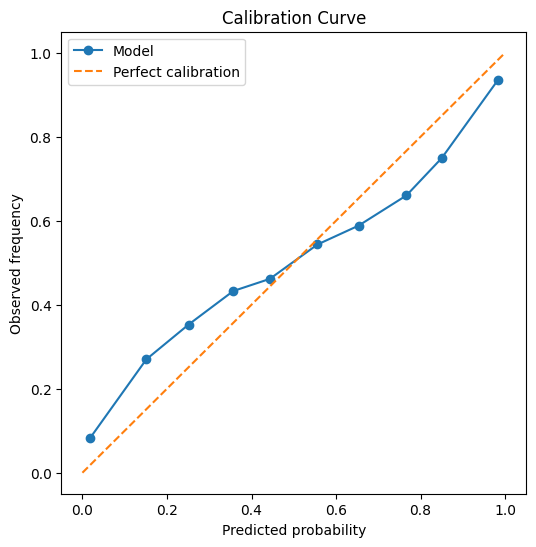

Total Value Bets: 1980
ROI per bet: 0.080
95% ROI CI: 0.029 - 0.131
ROI if betting all matches as favorite: -0.055


/tmp/ipykernel_8288/35141329.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[0.06 0.07 0.03 ... 0.29 0.46 0.88]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  test_df.loc[vb, 'BetReturn'] = (


In [ ]:
from sklearn.calibration import calibration_curve

#df_2025 = match_df.loc[X_test.index].copy()
test_df['ImpliedProb'] = 1 / test_df['AvgOdds']

true, pred = calibration_curve(test_df['Outcome'], test_df['ModelProb'], n_bins=10)
plt.figure(figsize=(6,6))
plt.plot(pred, true, marker='o', label='Model')
plt.plot([0,1], [0,1], linestyle='--', label='Perfect calibration')
plt.xlabel('Predicted probability')
plt.ylabel('Observed frequency')
plt.title('Calibration Curve')
plt.legend()
plt.show()

test_df['EV'] = (test_df['ModelProb'] * (test_df['AvgOdds'] - 1)) - (1 - test_df['ModelProb'])
test_df['IsValueBet'] = test_df['EV'] > 0
test_df['BetReturn'] = 0
vb = test_df['IsValueBet']
test_df.loc[vb, 'BetReturn'] = (
    test_df.loc[vb, 'Outcome'] * (test_df.loc[vb, 'AvgOdds'] - 1)
    - (1 - test_df.loc[vb, 'Outcome'])
)

total_bets = vb.sum()
total_return = test_df.loc[vb, 'BetReturn'].sum()
roi = total_return / total_bets if total_bets > 0 else 0

print(f"Total Value Bets: {total_bets}")
print(f"ROI per bet: {roi:.3f}")

profits = test_df.loc[vb, 'BetReturn'].values
n_boot = 10000
boot_rois = []
for _ in range(n_boot):
    sample = np.random.choice(profits, size=len(profits), replace=True)
    boot_rois.append(sample.mean())
ci_lower = np.percentile(boot_rois, 2.5)
ci_upper = np.percentile(boot_rois, 97.5)
print(f"95% ROI CI: {ci_lower:.3f} - {ci_upper:.3f}")

test_df['FavoriteBetReturn'] = test_df['Outcome'] * (test_df['AvgOdds'] - 1) - (1 - test_df['Outcome'])
fav_roi = test_df['FavoriteBetReturn'].mean()
print(f"ROI if betting all matches as favorite: {fav_roi:.3f}")


Total Value Bets: 1980
Final Bankroll: 1158.10
Total ROI: 0.158


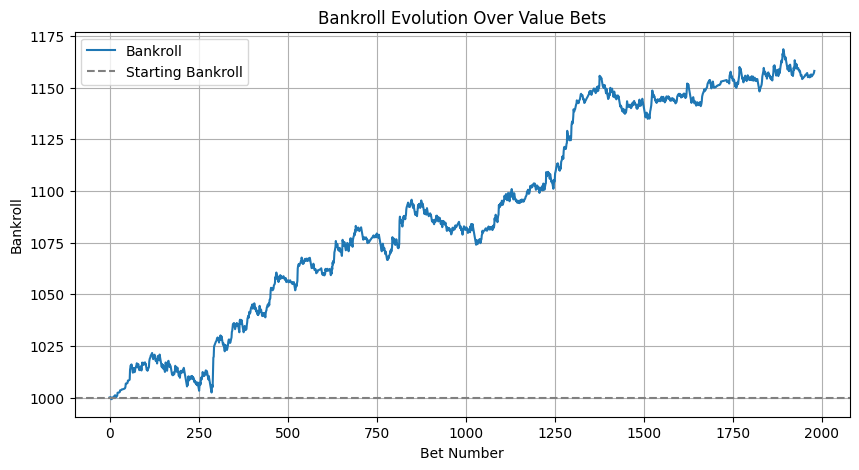

In [137]:
bankroll = 1000
bankroll_history = []
bet_indices = []

for idx, row in test_df[test_df['IsValueBet']].iterrows():
    bet_return = row['Outcome'] * (row['AvgOdds'] - 1) - (1 - row['Outcome'])
    bankroll += bet_return
    bankroll_history.append(bankroll)
    bet_indices.append(idx)

test_df.loc[bet_indices, 'Bankroll'] = bankroll_history

test_df['Bankroll'] = test_df['Bankroll'].ffill().fillna(1000)

print(f"Total Value Bets: {len(bet_indices)}")
print(f"Final Bankroll: {bankroll:.2f}")
print(f"Total ROI: {(bankroll - 1000) / 1000:.3f}")

plt.figure(figsize=(10,5))
plt.plot(range(len(bankroll_history)), bankroll_history, label="Bankroll")
plt.axhline(1000, color="gray", linestyle="--", label="Starting Bankroll")
plt.xlabel('Bet Number')
plt.ylabel('Bankroll')
plt.title('Bankroll Evolution Over Value Bets')
plt.legend()
plt.grid(True)
plt.show()


Total Value Bets: 1980
Final Bankroll: 8892.41
Total ROI: 87.924


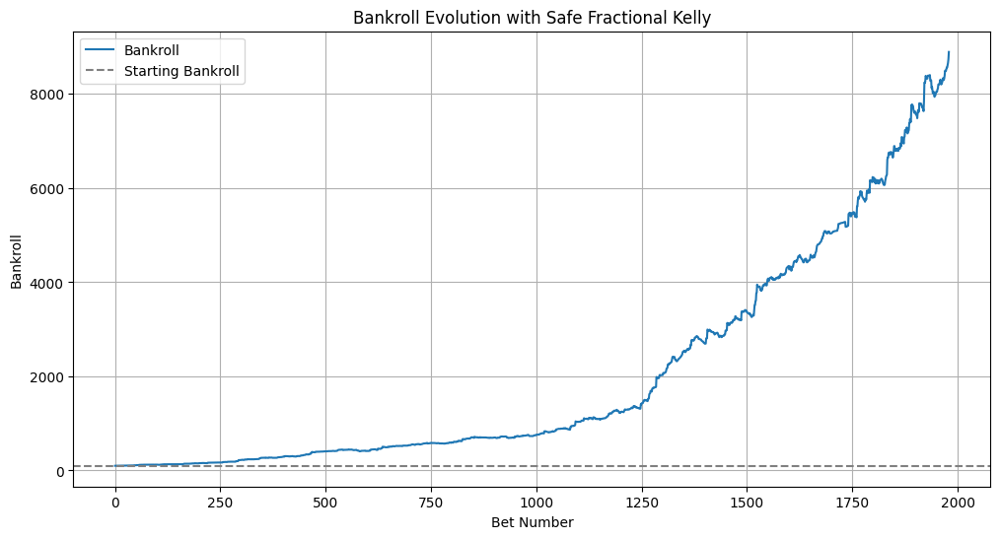

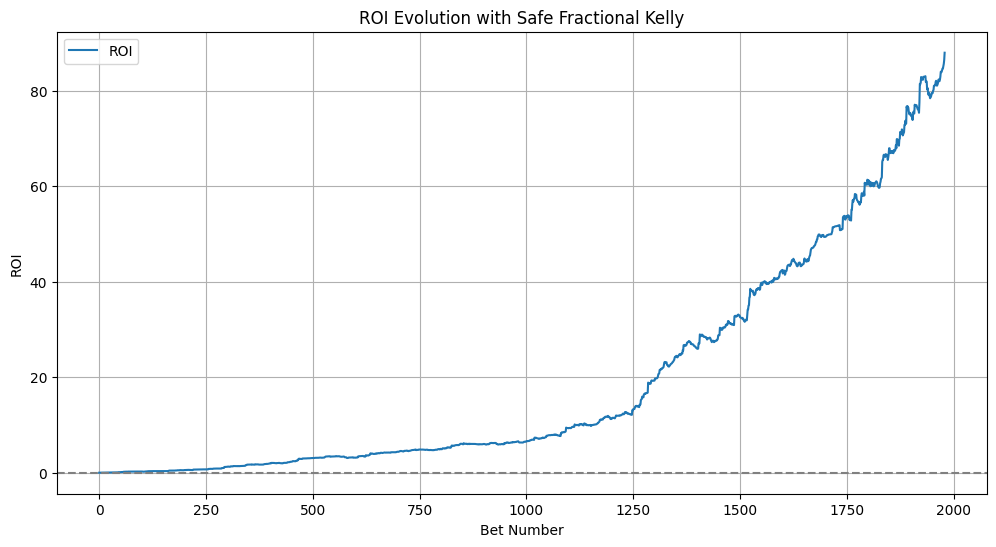

In [ ]:

initial_bankroll = 100
bankroll = initial_bankroll
kelly_fraction = 0.02   
max_bet_fraction = 0.02 
prob_noise_std = 0.05

bankroll_history = []
roi_history = []
bet_indices = []

for idx, row in test_df[test_df['IsValueBet']].iterrows():
    odds = row['AvgOdds']
    
    p = row['ModelProb'] + np.random.normal(0, prob_noise_std)
    p = min(max(p, 0), 1) 
    
    b = odds - 1
    q = 1 - p
    
    kelly_stake = kelly_fraction * max((b * p - q) / b, 0)
    kelly_stake = min(kelly_stake, max_bet_fraction)
    
    bet_return = bankroll * kelly_stake * (row['Outcome'] * b - (1 - row['Outcome']))
    
    bankroll += bet_return
    bankroll_history.append(bankroll)
    roi_history.append((bankroll - initial_bankroll) / initial_bankroll)
    bet_indices.append(idx)


test_df.loc[bet_indices, 'Bankroll'] = bankroll_history
test_df['Bankroll'] = test_df['Bankroll'].ffill().fillna(initial_bankroll)


print(f"Total Value Bets: {len(bet_indices)}")
print(f"Final Bankroll: {bankroll:.2f}")
print(f"Total ROI: {(bankroll - initial_bankroll) / initial_bankroll:.3f}")


plt.figure(figsize=(12,6))
plt.plot(range(len(bankroll_history)), bankroll_history, label="Bankroll")
plt.axhline(initial_bankroll, color="gray", linestyle="--", label="Starting Bankroll")
plt.xlabel('Bet Number')
plt.ylabel('Bankroll')
plt.title('Bankroll Evolution with Safe Fractional Kelly')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12,6))
plt.plot(range(len(roi_history)), roi_history, label="ROI")
plt.axhline(0, color="gray", linestyle="--")
plt.xlabel('Bet Number')
plt.ylabel('ROI')
plt.title('ROI Evolution with Safe Fractional Kelly')
plt.legend()
plt.grid(True)
plt.show()


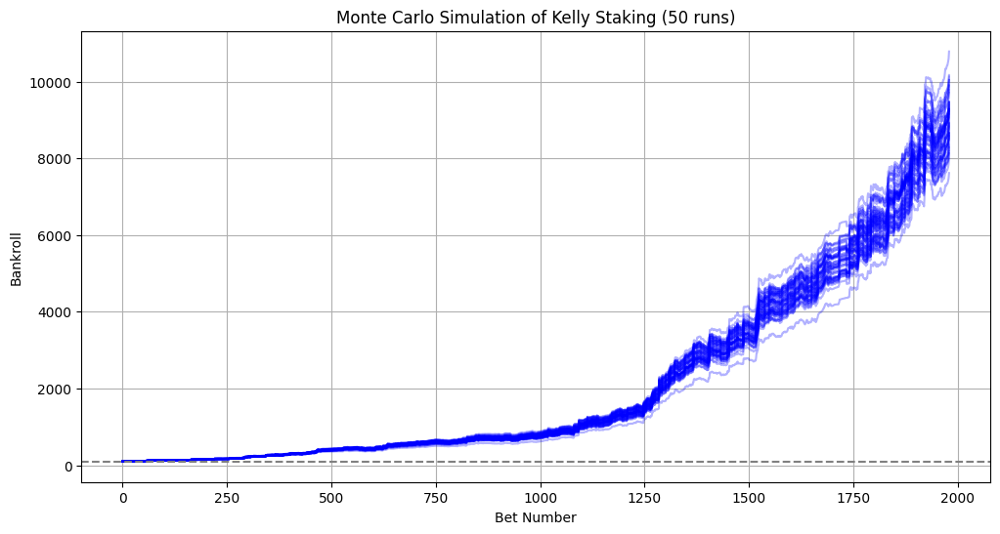

Mean Final Bankroll: 9071.62
Median Final Bankroll: 9109.57
Min Final Bankroll: 7616.59
Max Final Bankroll: 10784.56
Mean ROI: 89.72


In [ ]:
initial_bankroll = 100
kelly_fraction = 0.02
max_bet_fraction = 0.02
prob_noise_std = 0.05
num_simulations = 50

bankroll_paths = []


for sim in range(num_simulations):
    bankroll = initial_bankroll
    bankroll_history = []

    for idx, row in test_df[test_df['IsValueBet']].iterrows():
        odds = row['AvgOdds']
        
        p = row['ModelProb'] + np.random.normal(0, prob_noise_std)
        p = np.clip(p, 0, 1)
        
        b = odds - 1
        q = 1 - p
        
        kelly_stake = kelly_fraction * max((b * p - q) / b, 0)
        kelly_stake = min(kelly_stake, max_bet_fraction)
        
        bet_return = bankroll * kelly_stake * (row['Outcome'] * b - (1 - row['Outcome']))
        bankroll += bet_return
        bankroll_history.append(bankroll)
    
    bankroll_paths.append(bankroll_history)


bankroll_paths = np.array(bankroll_paths)


plt.figure(figsize=(12,6))
for i in range(num_simulations):
    plt.plot(bankroll_paths[i], color='blue', alpha=0.3)
plt.axhline(initial_bankroll, color='gray', linestyle='--', label="Starting Bankroll")
plt.xlabel('Bet Number')
plt.ylabel('Bankroll')
plt.title(f'Monte Carlo Simulation of Kelly Staking ({num_simulations} runs)')
plt.grid(True)
plt.show()


final_bankrolls = bankroll_paths[:, -1]
print(f"Mean Final Bankroll: {np.mean(final_bankrolls):.2f}")
print(f"Median Final Bankroll: {np.median(final_bankrolls):.2f}")
print(f"Min Final Bankroll: {np.min(final_bankrolls):.2f}")
print(f"Max Final Bankroll: {np.max(final_bankrolls):.2f}")
print(f"Mean ROI: {(np.mean(final_bankrolls) - initial_bankroll)/initial_bankroll:.2f}")
